# Getting Started with GEDI L1B Version 2 Data in Python

In this tutorial, our main focus is the Reynolds Creek Experimental Watershed (RCEW), Idaho. RCEW has a semi-arid ecosystem. 

### This tutorial demonstrates how to work with the Geolocated Waveform ([GEDI01_B.002](https://doi.org/10.5067/GEDI/GEDI01_B.002)) data product.
The Global Ecosystem Dynamics Investigation ([GEDI](https://lpdaac.usgs.gov/data/get-started-data/collection-overview/missions/gedi-overview/)) mission aims to characterize ecosystem structure and dynamics to enable radically improved quantification and understanding of the Earth's carbon cycle and biodiversity. The GEDI instrument produces high resolution laser ranging observations of the 3-dimensional structure of the Earth. GEDI is attached to the International Space Station and collects data globally between 51.6 N and 51.6 S latitudes at the highest resolution and densest sampling of any light detection and ranging (lidar) instrument in orbit to date. The Land Processes Distributed Active Archive Center (LP DAAC) distributes the GEDI Level 1 and Level 2 Version 1 and Version 2 products. The L1B and L2 GEDI products are archived and distributed in the HDF-EOS5 file format. 

---
## Use Case Example:  
This tutorial was developed using an example use case for a project being worked on by Titus Nyarko Nde. This projects counts towards his Ph.D. **The goal of this tutorial is to use GEDI L1B Version 2 data to observe GEDI waveforms over RCEW.** 

This tutorial will show how to use Python to open GEDI L1B Version 2 files, visualize the sub-orbit of GEDI points (shots), subset to a region of interest, visualize GEDI full waveforms, and export subsets of GEDI science dataset (SDS) layers as GeoJSON files that can be loaded into GIS and/or Remote Sensing software programs. 

***    
### Data Used in the Example:  
- **GEDI L1B Geolocated Waveform Data Global Footprint Level - [GEDI01_B.002](https://doi.org/10.5067/GEDI/GEDI01_B.002)**
    - _The purpose of the L1B dataset is to provide geolocated waveforms and supporting datasets for each laser shot for all eight GEDI beams. This includes corrected and smoothed waveforms, geolocation parameters, and geophysical corrections._  
     - **Science Dataset (SDS) layers:**  
        - /geolocation/latitude_bin0  
        - /geolocation/longitude_bin0  
        - /shot_number  
        - /stale_return_flag  
        - /geolocation/degrade  
        - /rx_sample_count  
        - /rx_sample_start_index  
        - /rxwaveform  
        - /geolocation/elevation_bin0  
        - /geolocation/elevation_lastbin  
        - /geolocation/digital_elevation_model  

***  
# Topics Covered:
1. [**Get Started**](#getstarted)  
    1.1 Import Packages    
    1.2 Set Up the Working Environment and Retrieve Files      
2. [**Import and Interpret Data**](#importinterpret)      
    2.1 Open a GEDI HDF5 File and Read File Metadata     
    2.2 Read SDS Metadata and Subset by Beam   
3. [**Visualize a GEDI Sub-Orbit**](#visualizeorbit)      
    3.1 Subset by Layer and Create a Geodataframe   
    3.2 Visualize a Geodataframe
4. [**Subset and Visualize Waveforms**](#subsetviswaveforms)        
    4.1 Import and Extract Waveforms   
    4.2 Visualize Waveforms  
5. [**Quality Filtering**](#quality)      
6. [**Plot Profile Transects**](#plottransects)    
    6.1 Subset Beam Transects    
    6.2 Plot Waveform Transects   
7. [**Spatial Visualization**](#spatialvisualization)    
    7.1 Import, Subset, and Quality Filter All Beams      
    7.2 Spatial Subsetting   
    7.3 Visualize All Beams: Elevation  
8. [**Export Subsets as GeoJSON Files**](#exportgeojson)               
***


# 1. Get Started <a id="getstarted"></a>

## 1.1 Import Packages <a id="1.1"></a>
#### Import the required packages and set the input/working directory to run this Jupyter Notebook locally.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
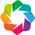

In [4]:
import os
import h5py
import numpy as np
import pandas as pd
import geopandas as gp
import geoviews as gv
from geoviews import opts, tile_sources as gvts
import holoviews as hv
gv.extension('bokeh', 'matplotlib')
from shapely.geometry import Point
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning) 

os.chdir('../../') 

## 1.2 Set Up the Working Environment and Retrieve Files<a id="1.2"></a>
#### The input directory is defined as the current working directory. Note that you will need to have the Jupyter Notebook and example data (.h5 and .geojson) stored in this directory in order to execute the tutorial successfully. If the example data is stored in a different directory, specify the path to the example data below.

In [5]:
# inDir = os.getcwd()
inDir = "/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21"
inDir

'/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21'

In [6]:
out_dir = "/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21/"
# gediFiles = [g for g in os.listdir('data/') if g.startswith('GEDI02_A') and g.endswith('.h5')]  # List GEDI L2A .h5 files in the inDir
gediFiles = [g for g in os.listdir(out_dir) if g.startswith('GEDI01_B') and g.endswith('.h5')]  # List GEDI L2A .h5 files in the inDir
gediFiles

['GEDI01_B_2021128123009_O13613_03_T06830_02_005_02_V002.h5',
 'GEDI01_B_2021144061826_O13857_03_T07947_02_005_02_V002.h5',
 'GEDI01_B_2021140075110_O13796_03_T06677_02_005_02_V002.h5',
 'GEDI01_B_2021132105712_O13674_03_T00985_02_005_02_V002.h5',
 'GEDI01_B_2021185084021_O14494_02_T09795_02_005_02_V002.h5']


# 2. Reading and Interpreting the Data <a id="importinterpret"></a>

## 2.1 Open a GEDI HDF5 File and Read File Metadata <a id="2.1"></a>
#### Read the file using `h5py`. 

In [7]:
L1B = out_dir+f'{gediFiles[3]}'
L1B

'/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21/GEDI01_B_2021132105712_O13674_03_T00985_02_005_02_V002.h5'

#### The standard format  for GEDI Version 2 filenames is as follows:
> **GEDI01_B**: Product Short Name    
**2021132105712**: Julian Date and Time of Acquisition (YYYYDDDHHMMSS)  
**O13674**: Orbit Number  
**03**: Sub-Orbit Granule Number (1-4)  
**T00985**: Track Number (Reference Ground Track)   
**02**: Positioning and Pointing Determination System (PPDS) type (00 is predict, 01 rapid, 02 and higher is final)  
**005**: PGE Version Number    
**02**: Granule Production Version  
**V002**: Product Version  

In [8]:
import h5py

# Open the GEDI file
file_path = L1B
with h5py.File(file_path, 'r') as f:
    # List all datasets and groups
    def print_attrs(name, obj):
        print(f"{name}:")
        for key, value in obj.attrs.items():
            print(f"  {key}: {value}")
        print()

    # Print all datasets with their attributes
    f.visititems(print_attrs)


BEAM0000:
  description: Coverage beam
  wp-l1a-to-l1b_githash: b'4ef3ac90d4e97dd775ba07138de2216a356e6d71'
  wp-l1a-to-l1b_version: b'20201118.0.0'

BEAM0000/all_samples_sum:
  coordinates: delta_time
  description: Sum of all values within the 10 km range window.
  long_name: All samples sum
  source: L0B
  units: counts from the ADC (Analog-to-Digital Converter)

BEAM0000/ancillary:

BEAM0000/ancillary/master_time_epoch:
  description: Number of GPS seconds between the GPS epoch (1980-01-06T00:00:00Z) and the GEDI epoch (2018-01-01T00:00:00Z). Add this value to delta_time parameters to compute full GPS seconds (relative to the GPS epoch) for each data point.
  long_name: Master time epoch
  units: seconds

BEAM0000/ancillary/mean_samples:
  description: Averaging window (shots) for non-repeated odd-even measurements from housekeeping.
  long_name: Mean samples
  source: Configuration
  units: shots

BEAM0000/ancillary/smoothing_width:
  description: The 1-sigma width (nsec) of the g

#### Read in a GEDI HDF5 file using the `h5py` package.

In [9]:
gediL1B = h5py.File(L1B, 'r')  # Read file using h5py

#### Navigate the HDF5 file below. 

In [10]:
list(gediL1B.keys())

['BEAM0000',
 'BEAM0001',
 'BEAM0010',
 'BEAM0011',
 'BEAM0101',
 'BEAM0110',
 'BEAM1000',
 'BEAM1011',
 'METADATA']

#### The GEDI HDF5 file contains groups in which data and metadata are stored.
#### First, the `METADATA` group contains the file-level metadata.

In [11]:
list(gediL1B['METADATA'])

['DatasetIdentification']

This contains useful information such as the creation date, PGEVersion, and VersionID. Below, print the file-level metadata attributes.

In [12]:
for g in gediL1B['METADATA']['DatasetIdentification'].attrs: print(g) 

PGEVersion
VersionID
abstract
characterSet
creationDate
credit
fileName
language
originatorOrganizationName
purpose
shortName
spatialRepresentationType
status
topicCategory
uuid


In [13]:
print(gediL1B['METADATA']['DatasetIdentification'].attrs['purpose'])

The purpose of the L1B dataset is to provide geolocated waveforms and supporting datasets for each laser shot for all eight GEDI beams.  This includes corrected and smoothed waveforms, geolocation parameters, and geophysical corrections.


## 2.2 Read SDS Metadata and Subset by Beam <a id="2.2"></a>

####  The GEDI instrument consists of 3 lasers producing a total of 8 beam ground transects. The eight remaining groups contain data for each of the eight GEDI beam transects. For additional information, be sure to check out: https://gedi.umd.edu/instrument/specifications/.

In [14]:
beamNames = [g for g in gediL1B.keys() if g.startswith('BEAM')]
beamNames

['BEAM0000',
 'BEAM0001',
 'BEAM0010',
 'BEAM0011',
 'BEAM0101',
 'BEAM0110',
 'BEAM1000',
 'BEAM1011']

#### One useful piece of metadata to retrieve from each beam transect is whether it is a full power beam or a coverage beam. 

In [15]:
for g in gediL1B['BEAM0000'].attrs: print(g)

description
wp-l1a-to-l1b_githash
wp-l1a-to-l1b_version


In [16]:
for b in beamNames: 
    print(f"{b} is a {gediL1B[b].attrs['description']}")

BEAM0000 is a Coverage beam
BEAM0001 is a Coverage beam
BEAM0010 is a Coverage beam
BEAM0011 is a Coverage beam
BEAM0101 is a Full power beam
BEAM0110 is a Full power beam
BEAM1000 is a Full power beam
BEAM1011 is a Full power beam


#### Below, pick one of the full power beams that will be used to retrieve GEDI L1B waveforms in Section 3. 

In [17]:
beamNames = ['BEAM0110']

#### Identify all the objects in the GEDI HDF5 file below. 
Note: This step may take a while to complete.

In [18]:
gediL1B_objs = []
gediL1B.visit(gediL1B_objs.append)                                           # Retrieve list of datasets
gediSDS = [o for o in gediL1B_objs if isinstance(gediL1B[o], h5py.Dataset)]  # Search for relevant SDS inside data file
[i for i in gediSDS if beamNames[0] in i][0:10]                              # Print the first 10 datasets for selected beam

['BEAM0110/all_samples_sum',
 'BEAM0110/ancillary/master_time_epoch',
 'BEAM0110/ancillary/mean_samples',
 'BEAM0110/ancillary/smoothing_width',
 'BEAM0110/beam',
 'BEAM0110/channel',
 'BEAM0110/geolocation/altitude_instrument',
 'BEAM0110/geolocation/altitude_instrument_error',
 'BEAM0110/geolocation/bounce_time_offset_bin0',
 'BEAM0110/geolocation/bounce_time_offset_bin0_error']


# 3. Visualize a GEDI Orbit <a id="visualizeorbit"></a>
#### In the section below, import GEDI L1B SDS layers into a `GeoPandas` GeoDataFrame for the beam specified above. 
#### Use the `latitude_bin0` and `longitude_bin0` to create a `shapely` point for each GEDI shot location. 

## 3.1 Subset by Layer and Create a Geodataframe <a id="3.1"></a>

#### Read in the SDS and take a representative sample (for instance every 50th or 100th shot) and append to lists, then use the lists to generate a `pandas` dataframe.

In [19]:
lonSample, latSample, shotSample, srfSample, degradeSample, beamSample = [], [], [], [], [], []  # Set up lists to store data

# Open the SDS
lats = gediL1B[f'{beamNames[0]}/geolocation/latitude_bin0'][()]
lons = gediL1B[f'{beamNames[0]}/geolocation/longitude_bin0'][()]
shots = gediL1B[f'{beamNames[0]}/shot_number'][()]
srf = gediL1B[f'{beamNames[0]}/stale_return_flag'][()]
degrade = gediL1B[f'{beamNames[0]}/geolocation/degrade'][()]

# Take every 100th shot and append to list
for i in range(len(shots)):
    # if i % 100 == 0:
    if i % 50 == 0:
        shotSample.append(str(shots[i]))
        lonSample.append(lons[i])
        latSample.append(lats[i])
        srfSample.append(srf[i])
        degradeSample.append(degrade[i])
        beamSample.append(beamNames[0])
            
# Write all of the sample shots to a dataframe
latslons = pd.DataFrame({'Beam': beamSample, 'Shot Number': shotSample, 'Longitude': lonSample, 'Latitude': latSample,
                         'Stale Return Flag': srfSample, 'Degrade': degradeSample})
latslons

,Beam,Shot Number,Longitude,Latitude,Stale Return Flag,Degrade
0,BEAM0110,136740600300482000,-155.228271,51.776060,1,0
1,BEAM0110,136740600300482050,-155.207622,51.775689,1,0
2,BEAM0110,136740600300482100,-155.186985,51.775314,1,0
3,BEAM0110,136740600300482150,-155.166313,51.774953,1,0
4,BEAM0110,136740600300482200,-155.145709,51.774581,1,0
...,...,...,...,...,...,...
3385,BEAM0110,136740600300651250,-73.271643,0.294601,0,30
3386,BEAM0110,136740600300651300,-73.256218,0.272697,1,0
3387,BEAM0110,136740600300651350,-73.241402,0.251670,0,0
3388,BEAM0110,136740600300651400,-73.225979,0.229741,1,30


#### Above is a dataframe containing columns describing the beam, shot number, lat/lon location, and quality information about each shot.

In [20]:
# Clean up variables that will no longer be needed
del beamSample, degrade, degradeSample, gediL1B_objs, latSample, lats, lonSample, lons, shotSample, shots, srf, srfSample 

#### Below, create an additional column called 'geometry' that contains a `shapely` point generated from each lat/lon location from the shot. 

In [21]:
# Take the lat/lon dataframe and convert each lat/lon to a shapely point
latslons['geometry'] = latslons.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)

#### Next, convert to a `Geopandas` GeoDataFrame.

In [22]:
# Convert to a Geodataframe
latslons = gp.GeoDataFrame(latslons)
latslons = latslons.drop(columns=['Latitude','Longitude'])
latslons['geometry']

0       POINT (-155.22827 51.77606)
1       POINT (-155.20762 51.77569)
2       POINT (-155.18699 51.77531)
3       POINT (-155.16631 51.77495)
4       POINT (-155.14571 51.77458)
                   ...             
3385       POINT (-73.27164 0.2946)
3386       POINT (-73.25622 0.2727)
3387       POINT (-73.2414 0.25167)
3388      POINT (-73.22598 0.22974)
3389      POINT (-73.21059 0.20787)
Name: geometry, Length: 3390, dtype: geometry

#### Pull out and plot an example `shapely` point below.

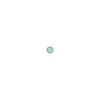

In [23]:
latslons['geometry'][0]

## 3.2 Visualize a GeoDataFrame <a id="3.2"></a>
#### In this section, use the GeoDataFrame and the `geoviews` python package to spatially visualize the location of the GEDI shots on a basemap and import a GeoJSON file of the spatial region of interest for the use case example: Reynolds Creek Experimental Watershed (RCEW).

In [24]:
# Define a function for visualizing GEDI points
def pointVisual(features, vdims):
    return (gvts.EsriImagery * gv.Points(features, vdims=vdims).options(tools=['hover'], height=500, width=900, size=5, 
                                                                        color='yellow', fontsize={'xticks': 10, 'yticks': 10, 
                                                                                                  'xlabel':16, 'ylabel': 16}))

#### Import a GeoJSON (shapefile) of RCEW as an additional GeoDataFrame. Note that you will need to have the GeoJSON file saved in the same directory as this Jupyter Notebook. Else you will have to give the full path to the file.

In [25]:
rcew = gp.GeoDataFrame.from_file('/Users/titus/BSU/remote_sensing/carbon_estimation/shapefiles/RCEW-outline_WGS84_simple.geojson')  # Import GeoJSON as GeoDataFrame

In [26]:
rcew

,geometry
0,"POLYGON ((-116.799 43.06089, -116.7954 43.0608..."


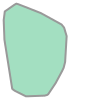

In [27]:
rcew['geometry'][0]  # Plot GeoDataFrame

#### Defining the vdims below will allow you to hover over specific shots and view information about them.

In [28]:
# Create a list of geodataframe columns to be included as attributes in the output map
vdims = []
for f in latslons:
    if f not in ['geometry']:
        vdims.append(f)
vdims

['Beam', 'Shot Number', 'Stale Return Flag', 'Degrade']

#### Below, combine a plot of the RCEW Boundary (combine two `geoviews` plots using `*`) with the point visual mapping function defined above in order to plot (1) the representative GEDI shots, (2) the region of interest, and (3) a basemap layer. 

In [29]:
# Call the function for plotting the GEDI points
gv.Polygons(rcew['geometry']).opts(line_color='red', color=None) * pointVisual(latslons, vdims = vdims)

:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Points.I   :Points   [Longitude,Latitude]   (Beam,Shot Number,Stale Return Flag,Degrade)

#### Above is a good illustration of the new GEDI _Version 2_ sub-orbit granules (remember that GEDI _Version 1_  files are stored as one ISS orbit). One of the benefits of using geoviews is the interactive nature of the output plots. Use the tools to the right of the map above to zoom in and find the shots intersecting RCEW. 

#### Side Note: Wondering what the 0's and 1's for `stale_return_flag` and `degrade` mean?

In [30]:
print(f"stale_return_flag: {gediL1B[b]['stale_return_flag'].attrs['description']}")
print(f"degrade: {gediL1B[b]['geolocation']['degrade'].attrs['description']}")

stale_return_flag: Indicates that a "stale" cue point from the coarse search algorithm is being used.
degrade: Non-zero values indicate the shot occured during a degraded period.  A non-zero tens digit indicates degraded attitude, a non-zero ones digit indicates a degraded trajectory.  3X=ADF CHU solution unavailable (ST-2); 4X=Platform attitude; 5X=Poor solution (filter covariance large); 6X=Data outage (platform attitude gap also); 7X=ST 1+2 unavailable (similar boresight FOV); 8X=ST 1+2+3 unavailable; 9X=ST 1+2+3 and ISS unavailable; X1=Maneuver; X2=GPS data gap; X3=ST blinding; X4=Other; X5=GPS receiver clock drift; X6=X5+X1; X7=X5+X2; X8=X5+X3; X9=X5+X4.


In [31]:
gediL1B[b]['stale_return_flag'].attrs.keys()

<KeysViewHDF5 ['coordinates', 'description', 'long_name', 'source', 'units', 'valid_range']>

#### We will show an example of how to quality filter GEDI data in section 5.
#### After finding one of the shots within RCEW, find the index for that shot number so that we can find the correct waveform to visualize in Section 4. 

#### Each GEDI shot has a unique shot identifier (shot number) that is available within each data group of the product. The shot number is important to retain in any data subsetting as it will allow the user to link any shot record back to the original orbit data, and to link any shot and its data between the L1 and L2 products. The standard format  for GEDI Version 2 Shots is as follows:

### Shot: 136740600300539400
**13674**: Orbit Number      
**06**: Beam Number    
**0**: Reserved for future use     
**03**: Sub-orbit Granule Number    
**005**: Minor frame number   
**39400**: Shot index  

In [32]:
shot = 136740600300539400

In [33]:
index = np.where(gediL1B[f'{beamNames[0]}/shot_number'][()]==shot)[0][0]  # Set the index for the shot identified above
index = int(index)
index

57400

In [34]:
del latslons  # No longer need the geodataframe used to visualize the full GEDI orbit


# 4. Subset and Visualize Waveforms <a id="subsetviswaveforms"></a>
#### In this section, learn how to extract and subset specific waveforms and plot them using `holoviews`. 

## 4.1 Import and Extract Waveforms<a id="4.1"></a>

#### In order to find and extract the full waveform for the exact index we are interested in, instead of importing the entire waveform dataset (over 100 million values!), we will use the `rx_sample_count` and `rx_sample_start_index` to identify the location of the waveform that we are interested in visualizing and just extract those values.

In [35]:
# From the SDS list, use list comprehension to find sample_count, sample_start_index, and rxwaveform
sdsCount = gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_count') and beamNames[0] in g][0]]
sdsStart = gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_start_index') and beamNames[0] in g][0]]
sdsWaveform = [g for g in gediSDS if g.endswith('/rxwaveform') and beamNames[0] in g][0]
sdsWaveform

'BEAM0110/rxwaveform'

#### Print the description for each of these datasets to better understand how we will use them to extract specific waveforms.

In [36]:
print(f"rxwaveform is {gediL1B[sdsWaveform].attrs['description']}")

rxwaveform is The corrected receive (RX) waveforms.  Use rx_sample_count and rx_sample_start_index to identify the location of each waveform.


#### Next, read how to use the rx_sample_count and rx_sample_start_index layers:

In [37]:
print(f"rx_sample_count is {sdsCount.attrs['description']}")
print(f"rx_sample_start_index is {sdsStart.attrs['description']}")

rx_sample_count is The number of sample intervals (elements) in each RX waveform.
rx_sample_start_index is The index in the rxwaveform dataset of the first element of each RX waveform.  The indices start at 1.


#### Use `rx_sample_count` and `rx_sample_start_index` to identify the location of each waveform in `rxwaveform`.

In [38]:
wfCount = sdsCount[index]           # Number of samples in the waveform
wfStart = sdsStart[index] - 1  # Subtract one because python array indexing starts at 0 not 1
wfStart

np.uint64(81508000)

#### Next grab additional information about the shot, including the unique `shot_number`, and lat/lon location.

In [39]:
wfShot = gediL1B[f'{beamNames[0]}/shot_number'][index]
wfLat = gediL1B[f'{beamNames[0]}/geolocation/latitude_bin0'][index]
wfLon = gediL1B[f'{beamNames[0]}/geolocation/longitude_bin0'][index]
wfLon

np.float64(-116.78376565785241)

#### Put everything together to identify the waveform we want to extract:

In [40]:
print(f"The waveform located at: {str(wfLat)}, {str(wfLon)} (shot ID: {wfShot}, index {index}) is from beam {beamNames[0]} \
      and is stored in rxwaveform beginning at index {wfStart} and ending at index {wfStart + wfCount}")

The waveform located at: 43.206641022549036, -116.78376565785241 (shot ID: 136740600300539400, index 57400) is from beam BEAM0110       and is stored in rxwaveform beginning at index 81508000 and ending at index 81508752


#### In order to plot a full waveform, you also need to import the elevation recorded at `bin0` (the first elevation recorded) and `lastbin` or the last elevation recorded for that waveform.

In [41]:
# Grab the elevation recorded at the start and end of the full waveform capture
zStart = gediL1B[f'{beamNames[0]}/geolocation/elevation_bin0'][index]   # Height of the start of the rx window
zEnd = gediL1B[f'{beamNames[0]}/geolocation/elevation_lastbin'][index]  # Height of the end of the rx window

### Extract the full waveform using the index start and count:
#### Below you can see why it is important to extract the specific waveform that you are interested in: over 100 million values are stored in the rxwaveform dataset!

In [42]:
print("{:,}".format(gediL1B[sdsWaveform].shape[0]))

240,636,040


In [43]:
# Retrieve the waveform sds layer using the sample start index and sample count information to slice the correct dimensions
waveform = gediL1B[sdsWaveform][wfStart: wfStart + wfCount]

## 4.2 Visualize Waveforms
#### Below, plot the extracted waveform using the elevation difference from bin0 to last_bin on the y axis, and the waveform energy returned or amplitude (digital number = dn) on the x axis. 

In [44]:
# Find elevation difference from start to finish and divide into equal intervals based on sample_count
zStretch = np.add(zEnd, np.multiply(range(wfCount, 0, -1), ((zStart - zEnd) / int(wfCount))))

In [45]:
# match the waveform amplitude values with the elevation and convert to Pandas df
wvDF = pd.DataFrame({'Amplitude (DN)': waveform, 'Elevation (m)': zStretch})
wvDF

,Amplitude (DN),Elevation (m)
0,227.807404,1269.831871
1,226.947525,1269.682271
2,226.242477,1269.532670
3,226.061707,1269.383069
4,226.423157,1269.233469
...,...,...
747,229.143524,1158.080199
748,229.810104,1157.930599
749,230.454529,1157.780998
750,230.773636,1157.631397


In [49]:
# waveform_csv = '/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21/output/shot_136740600300539400_waveform.csv'
# wvDF.to_csv(waveform_csv, index=False)

#### Next, use the `Holoviews` python package (hv) to plot the waveform.

In [59]:
hv.Curve(wvDF) # Basic line graph plotting the waveform

:Curve   [Amplitude (DN)]   (Elevation (m))

<!-- ### Congratulations! You have plotted your first waveform. -->
#### Above is a basic line plot showing amplitude (DN) as a function of elevation from the rxwaveform for the specific shot selected. Next, add additional chart elements and make the graph interactive.

In [60]:
# Create a holoviews interactive Curve plot with additional parameters defining the plot aesthetics 
wfVis = hv.Curve(wvDF).opts(color='darkgreen', tools=['hover'], height=500, width=400,
           xlim=(np.min(waveform) - 10, np.max(waveform) + 10), ylim=(np.min(zStretch), np.max(zStretch)),
           fontsize={'xticks':10, 'yticks':10,'xlabel':16, 'ylabel': 16, 'title':13}, line_width=2.5, title=f'{str(wfShot)}')
wfVis

:Curve   [Amplitude (DN)]   (Elevation (m))

#### As you can see, the selected shot does not look so interesting--this waveform shape looks more characteristic of some type of low canopy/bare ground than a tree canopy. If you zoom in to the GEDI shot it appears to be over bare ground.

#### Next, plot a couple more waveforms and see if you can capture a shot that looks a bit different.

In [61]:
latlons = {}                          # Set up a dictionary to hold multiple waveforms
latlons[wfShot] = Point(wfLon,wfLat)  # Create shapely point and add to dictionary

# Retain waveform and quality layers to be exported later
latlonsWF = [waveform]
latlonsEL = [zStretch]
latlonsSRF = [gediL1B[f'{beamNames[0]}/stale_return_flag'][index]]
latlonsD = [gediL1B[f'{beamNames[0]}/geolocation/degrade'][index]]

In [62]:
# Define which observation to examine by selecting the three indexes prior to the one used above
index = 57397 # (57400-3)

In [63]:
# Use rx_sample_count and rx_sample_start_index to identify the location of each waveform
wfCount = sdsCount[index]                                             # Number of samples in the waveform
wfStart = sdsStart[index] - 1                                    # Subtract 1, index starts at 0 not 1
wfShot = gediL1B[f'{beamNames[0]}/shot_number'][index]                # Unique Shot Number
wfLat = gediL1B[f'{beamNames[0]}/geolocation/latitude_bin0'][index]   # Latitude
wfLon = gediL1B[f'{beamNames[0]}/geolocation/longitude_bin0'][index]  # Longitude
latlons[wfShot] = Point(wfLon,wfLat)                                  # Create shapely point and add to dictionary

# Grab the elevation recorded at the start and end of the full waveform capture
zStart = gediL1B[f'{beamNames[0]}/geolocation/elevation_bin0'][index]   # Height of the start of the rx window
zEnd = gediL1B[f'{beamNames[0]}/geolocation/elevation_lastbin'][index]  # Height of the end of the rx window

# Retrieve the waveform sds layer using the sample start index and sample count information to slice the correct dimensions
waveform = gediL1B[sdsWaveform][wfStart: wfStart + wfCount]

In [64]:
# Find elevation difference from start to finish, divide into equal intervals
zStretch = np.add(zEnd, np.multiply(range(wfCount, 0, -1), ((zStart - zEnd) / int(wfCount))))

# match the waveform amplitude values with the elevation and convert to Pandas df
wvDF = pd.DataFrame({'Amplitude (DN)': waveform, 'Elevation (m)': zStretch})

In [65]:
# Append waveform and quality layers to be exported later
latlonsWF.append(waveform)
latlonsEL.append(zStretch)
latlonsSRF.append(gediL1B[f'{beamNames[0]}/stale_return_flag'][index])
latlonsD.append(gediL1B[f'{beamNames[0]}/geolocation/degrade'][index])

In [66]:
# Create a holoviews interactive Curve plot with additional parameters defining the plot aesthetics 
visL1B1 = hv.Curve(wvDF).opts(color='darkgreen', tools=['hover'], height=500, width=400,
           xlim=(np.min(waveform) - 10, np.max(waveform) + 10), ylim=(np.min(zStretch), np.max(zStretch)),
           fontsize={'xticks':10, 'yticks':10,'xlabel':16, 'ylabel': 16, 'title':13}, line_width=2.5, title=f'{str(wfShot)}')
visL1B1

:Curve   [Amplitude (DN)]   (Elevation (m))

#### Still looks similar to the previous one. Continue with the next shot:

In [67]:
# Define which observation to examine
index = 57396 # (57400-4)

In [68]:
# Use rx_sample_count and rx_sample_start_index to identify the location of each waveform
wfCount = sdsCount[index]                                             # Number of samples in the waveform
wfStart = sdsStart[index] - 1                                    # Subtract 1, index starts at 0 not 1
wfShot = gediL1B[f'{beamNames[0]}/shot_number'][index]                # Unique Shot Number
wfLat = gediL1B[f'{beamNames[0]}/geolocation/latitude_bin0'][index]   # Latitude
wfLon = gediL1B[f'{beamNames[0]}/geolocation/longitude_bin0'][index]  # Longitude
latlons[wfShot] = Point(wfLon,wfLat)                                  # Create shapely point and add to dictionary

# Grab the elevation recorded at the start and end of the full waveform capture
zStart = gediL1B[f'{beamNames[0]}/geolocation/elevation_bin0'][index]   # Height of the start of the rx window
zEnd = gediL1B[f'{beamNames[0]}/geolocation/elevation_lastbin'][index]  # Height of the end of the rx window

# Retrieve the waveform sds layer using the sample start index and sample count information to slice the correct dimensions
waveform = gediL1B[sdsWaveform][wfStart: wfStart + wfCount]

In [69]:
# Find elevation difference from start to finish, divide into equal intervals
zStretch = np.add(zEnd, np.multiply(range(wfCount, 0, -1), ((zStart - zEnd) / int(wfCount))))

# match the waveform amplitude values with the elevation and convert to Pandas df
wvDF = pd.DataFrame({'Amplitude (DN)': waveform, 'Elevation (m)': zStretch})

In [70]:
# Append waveform and quality layers to be exported later
latlonsWF.append(waveform)
latlonsEL.append(zStretch)
latlonsSRF.append(gediL1B[f'{beamNames[0]}/stale_return_flag'][index])
latlonsD.append(gediL1B[f'{beamNames[0]}/geolocation/degrade'][index])

In [71]:
# Create a holoviews interactive Curve plot with additional parameters defining the plot aesthetics 
visL1B2 = hv.Curve(wvDF).opts(color='darkgreen', tools=['hover'], height=500, width=400,
           xlim=(np.min(waveform) - 10, np.max(waveform) + 10), ylim=(np.min(zStretch), np.max(zStretch)),
           fontsize={'xticks':10, 'yticks':10,'xlabel':16, 'ylabel': 16, 'title':13}, line_width=2.5, title=f'{str(wfShot)}')
visL1B2

:Curve   [Amplitude (DN)]   (Elevation (m))

In [74]:
# Define which observation to examine
index = 57500 # (57400+100)

In [75]:
# Use rx_sample_count and rx_sample_start_index to identify the location of each waveform
wfCount = sdsCount[index]                                             # Number of samples in the waveform
wfStart = sdsStart[index] - 1                                    # Subtract 1, index starts at 0 not 1
wfShot = gediL1B[f'{beamNames[0]}/shot_number'][index]                # Unique Shot Number
wfLat = gediL1B[f'{beamNames[0]}/geolocation/latitude_bin0'][index]   # Latitude
wfLon = gediL1B[f'{beamNames[0]}/geolocation/longitude_bin0'][index]  # Longitude
latlons[wfShot] = Point(wfLon,wfLat)                                  # Create shapely point and add to dictionary

# Grab the elevation recorded at the start and end of the full waveform capture
zStart = gediL1B[f'{beamNames[0]}/geolocation/elevation_bin0'][index]   # Height of the start of the rx window
zEnd = gediL1B[f'{beamNames[0]}/geolocation/elevation_lastbin'][index]  # Height of the end of the rx window

# Retrieve the waveform sds layer using the sample start index and sample count information to slice the correct dimensions
waveform = gediL1B[sdsWaveform][wfStart: wfStart + wfCount]

In [76]:
# Find elevation difference from start to finish, divide into equal intervals
zStretch = np.add(zEnd, np.multiply(range(wfCount, 0, -1), ((zStart - zEnd) / int(wfCount))))

# match the waveform amplitude values with the elevation and convert to Pandas df
wvDF = pd.DataFrame({'Amplitude (DN)': waveform, 'Elevation (m)': zStretch})

In [77]:
# Append waveform and quality layers to be exported later
latlonsWF.append(waveform)
latlonsEL.append(zStretch)
latlonsSRF.append(gediL1B[f'{beamNames[0]}/stale_return_flag'][index])
latlonsD.append(gediL1B[f'{beamNames[0]}/geolocation/degrade'][index])

In [78]:
# Create a holoviews interactive Curve plot with additional parameters defining the plot aesthetics 
visL1B3 = hv.Curve(wvDF).opts(color='darkgreen', tools=['hover'], height=500, width=400,
           xlim=(np.min(waveform) - 10, np.max(waveform) + 10), ylim=(np.min(zStretch), np.max(zStretch)),
           fontsize={'xticks':10, 'yticks':10,'xlabel':16, 'ylabel': 16, 'title':13}, line_width=2.5, title=f'{str(wfShot)}')
visL1B3

:Curve   [Amplitude (DN)]   (Elevation (m))

#### Lastly, plot the transect of the four waveforms:

In [65]:
# The "+" symbol will plot multiple saved holoviews plots together
visL1B1.opts(width=240) + visL1B2.opts(width=240, labelled=[]) + visL1B3.opts(width=240, labelled=[]) + \
wfVis.opts(width=240, labelled=[])

:Layout
   .Curve.I   :Curve   [Amplitude (DN)]   (Elevation (m))
   .Curve.II  :Curve   [Amplitude (DN)]   (Elevation (m))
   .Curve.III :Curve   [Amplitude (DN)]   (Elevation (m))
   .Curve.IV  :Curve   [Amplitude (DN)]   (Elevation (m))

<!-- #### Notice above moving west to east (left to right) along the transect you can see the elevation lowering and the tree canopy decreasing as it encounters the sandbar/river. -->
#### The waveform for all the selected shots look very similar and are typical of the waveform structure for bare earth/ground or very low vegetation.

#### Below, use geoviews to plot the location of the four points to verify what is seen above.

In [79]:
# Convert dict to geodataframe
latlons = gp.GeoDataFrame({'Shot Number': list(latlons.keys()),'rxwaveform Amplitude (DN)': latlonsWF,
                           'rxwaveform Elevation (m)': latlonsEL, 'Stale Return Flag': latlonsSRF, 'Degrade': latlonsD,
                           'geometry': list(latlons.values())})

In [80]:
latlons['Shot Number'] = latlons['Shot Number'].astype(str)  # Convert shot number from integer to string

In [81]:
vdims

['Beam', 'Shot Number', 'Stale Return Flag', 'Degrade']

In [82]:
# Create a list of geodataframe columns to be included as attributes in the output map
vdims = []
for f in latlons:
    if f not in ['geometry']:
        if 'rxwaveform' not in f:
            vdims.append(f)

# Plot the geodataframe
gv.Polygons(rcew['geometry']).opts(line_color='red', color=None) * pointVisual(latlons, vdims=vdims)

:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Points.I   :Points   [Longitude,Latitude]   (Shot Number,Stale Return Flag,Degrade)

#### Above, zoom in on the yellow dots until you can get a clearer view of all four shots.

In [83]:
del wfVis, visL1B1, visL1B2, visL1B3, waveform, wvDF, zStretch, latlonsWF, latlonsEL, latlonsSRF, latlonsD


# 5. Quality Filtering <a id="quality"></a>
#### Now that you have the desired layers imported as a dataframe for the selected shots, let's perform quality filtering.
#### Below, remove any shots where the `stale_return_flag` and `degrade` flag is not set to 0.  
#### Non-zero `stale_return_flag` indicates that a "stale" cue point from the coarse search algorithm is being used. The syntax of the line below finds the rows "where" the stale return flag is equal to 0 (better quality) in the dataframe. If a row (shot) does not meet the condition, set all values equal to `nan` for that row.

In [84]:
latlons = latlons.where(latlons['Stale Return Flag'] == 0)  # Set any stale returns to NaN

#### Non-zero values for the `degrade` flag indicate the shot occured during a degraded period. Therefore in a same way, the rows "where" the `degrade` flag is equal to 0 (better quality) are found. If a row (shot) does not meet the condition, set all values equal to `nan` for that row.

In [85]:
latlons = latlons.where(latlons['Degrade'] == 0)

#### Below, drop all of the shots that did not pass the quality filtering standards outlined above from the `transectDF`.

In [86]:
latlons = latlons.dropna()  # Drop all of the rows (shots) that did not pass the quality filtering above

In [87]:
print(f"Quality filtering complete, {len(latlons)} high quality shots remaining.")

Quality filtering complete, 4 high quality shots remaining.


#### Good news! It looks like all four of the example waveforms passed the initial quality filtering tests. For additional information on quality filtering GEDI data, be sure to check out: https://lpdaac.usgs.gov/resources/faqs/#how-should-i-quality-filter-gedi-l1b-l2b-data.

In [88]:
del latlons


# 6. Plot Profile Transects <a id="plottransects"></a>
#### In this section, plot a transect subset using waveforms.

## 6.1 Subset Beam Transects

#### Subset down to a smaller transect centered on the waveforms analyzed in the sections above.

In [89]:
print(index)

57500


In [90]:
# Grab 50 points before and after the shot visualized above
start = index - 50
end = index + 50 
transectIndex = np.arange(start, end, 1)

## 6.2 Plot Waveform Transects

#### In order to get an idea of the length of the beam transect that you are plotting, you can plot the x-axis as distance, which is calculated below.

In [91]:
# Calculate along-track distance
distance = np.arange(0.0, len(transectIndex) * 60, 60)  # GEDI Shots are spaced 60 m apart

#### In order to plot each vertical value for each waveform, you will need to reformat the data structure to match what is needed by `holoviews` Path() capabilities. 

In [92]:
# Create a list of tuples containing Shot number, and each waveform value at height (z)
wfList = []
for s, i in enumerate(transectIndex):
    # Basic quality filtering from section 5
    if gediL1B['BEAM0110/geolocation/degrade'][i] == 0 and gediL1B['BEAM0110/stale_return_flag'][i] == 0:
        zStart = gediL1B['BEAM0110/geolocation/elevation_bin0'][i]
        zEnd = gediL1B['BEAM0110/geolocation/elevation_lastbin'][i]
        zCount = sdsCount[i]
        zStretch = np.add(zEnd, np.multiply(range(zCount, 0, -1), ((zStart - zEnd) / int(zCount))))
        waveform = gediL1B[sdsWaveform][sdsStart[i]: sdsStart[i] + zCount]
        waves = []
        for z, w in enumerate(waveform):
            waves.append((distance[s], zStretch[z],w))  # Append Distance (x), waveform elevation (y) and waveform amplitude (z)
        wfList.append(waves)
    else:
        print(f"Shot {s} did not pass quality filtering and will be excluded.")

Shot 0 did not pass quality filtering and will be excluded.
Shot 1 did not pass quality filtering and will be excluded.
Shot 2 did not pass quality filtering and will be excluded.
Shot 3 did not pass quality filtering and will be excluded.
Shot 4 did not pass quality filtering and will be excluded.
Shot 5 did not pass quality filtering and will be excluded.
Shot 6 did not pass quality filtering and will be excluded.
Shot 7 did not pass quality filtering and will be excluded.


In [93]:
len(wfList)

92

#### It looks like some of the waveforms in our transect did not pass the quality filtering test.

### Below, plot each waveform by using `holoviews` Path() function. This will plot each individual waveform value by distance, with the amplitude plotted in the third dimension in shades of green.

In [94]:
import warnings
warnings.filterwarnings('ignore')
# Plot the waveform values for the transect with the waveform amplitude being plotted as the 'c' or colormap
l1bVis = hv.Path(wfList, vdims='Amplitude').options(color='Amplitude', clim=(200,405), cmap='Greens', line_width=20, width=950,
                                                    height=500, clabel='Amplitude',colorbar=True, 
                                                    xlabel='Distance Along Transect (m)', ylabel='Elevation (m)', 
                                                    fontsize={'title':16, 'xlabel':16, 'ylabel': 16, 'xticks':12, 'yticks':12, 
                                                              'clabel':12, 'cticks':10}, colorbar_position='right',
                                                    title='GEDI L1B Waveforms across Reynolds Creek Experimental Watershed')
l1bVis

:Path   [x,y]   (Amplitude)

#### If you zoom in to a subset of the transect, you can get even better detail showing the structure of the canopy from the `rxwaveform` dataset, where denser portions of the canopy are seen in darker shades of green.

In [95]:
del waveform, waves, wfList, zStretch


# 7. Spatial Visualization<a id="spatialvisualization"></a>
#### Section 7 combines many of the techniques learned above including how to import GEDI datasets, perform quality filtering, spatial subsetting, and visualization. 

## 7.1 Import, Subset, and Quality Filter All Beams

#### Below, re-open the GEDI L1B observation--but this time, loop through and import data for all 8 of the GEDI beams.

In [96]:
beamNames = [g for g in gediL1B.keys() if g.startswith('BEAM')]

In [97]:
beamNames

['BEAM0000',
 'BEAM0001',
 'BEAM0010',
 'BEAM0011',
 'BEAM0101',
 'BEAM0110',
 'BEAM1000',
 'BEAM1011']

#### Loop through each of the desired datasets (SDS) for each beam, append to lists, and transform into a `pandas` DataFrame.

In [98]:
# Set up lists to store data
shotNum, dem, zElevation, zHigh, zLat, zLon, srf, degrade, beamI, rxCount, rxStart = ([] for i in range(11))  

In [99]:
# Loop through each beam and open the SDS needed
for b in beamNames:
    [shotNum.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/shot_number') and b in g][0]][()]]
    [dem.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/digital_elevation_model') and b in g][0]][()]]
    [zElevation.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/elevation_bin0') and b in g][0]][()]]  
    [zHigh.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/elevation_lastbin') and b in g][0]][()]]  
    [zLat.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/latitude_bin0') and b in g][0]][()]]  
    [zLon.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/longitude_bin0') and b in g][0]][()]]  
    [srf.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/stale_return_flag') and b in g][0]][()]]  
    [degrade.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/degrade') and b in g][0]][()]]  
    [rxCount.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_count') and b in g][0]][()]]  
    [rxStart.append(h) for h in gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_start_index') and b in g][0]][()]]  
    [beamI.append(h) for h in [b] * len(gediL1B[[g for g in gediSDS if g.endswith('/shot_number') and b in g][0]][()])]  

#### Notice that we did not import the rxwaveform dataset--due to the large size of that dataset, we will wait until after spatial subsetting to import the waveforms.

In [100]:
# Convert lists to Pandas dataframe
allDF = pd.DataFrame({'Shot Number': shotNum, 'Beam': beamI, 'Latitude': zLat, 'Longitude': zLon, 'Tandem-X DEM': dem,
                      'Elevation bin 0 (m)': zElevation, 'Elevation last bin (m)': zHigh, 'Stale Return Flag': srf,
                      'Degrade Flag': degrade, 'rx Start Index': rxStart, 'rx Sample Count': rxCount})

In [101]:
del shotNum, dem, zElevation, zHigh, zLat, zLon, srf, degrade, beamI

## 7.2 Spatial Subsetting
#### Below, subset the pandas dataframe using a simple bounding box region of interest. If you are interested in spatially clipping GEDI shots to a GeoJSON region of interest, be sure to check out the GEDI-Subsetter python script available at: https://git.earthdata.nasa.gov/projects/LPDUR/repos/gedi-subsetter/browse.

In [102]:
len(allDF)

1291681

#### More than a million shots are contained in this single GEDI sub-orbit granule! Below subset down to only the shots falling within the region encompassing RCEW. `rcew` our `geopandas` geodataframe can be called for the "envelope" or smallest bounding box encompassing the entire region of interest. Here, use that as the bounding box for subsetting the GEDI shots.

In [89]:
rcew.envelope[0].bounds

(-116.8594, 43.06089, -116.6881, 43.31298)

In [104]:
minLon, minLat, maxLon, maxLat = rcew.envelope[0].bounds  # Define the min/max lat/lon from the bounds of RCEW

#### Filter by the bounding box, which is done similarly to filtering by quality in section 5 above.

In [105]:
allDF = allDF.where(allDF['Latitude'] > minLat)
allDF = allDF.where(allDF['Latitude'] < maxLat)
allDF = allDF.where(allDF['Longitude'] > minLon)
allDF = allDF.where(allDF['Longitude'] < maxLon)

### NOTE: It may take up to a few minutes to run the cell above.

In [106]:
allDF = allDF.dropna()  # Drop shots outside of the ROI

In [107]:
len(allDF)

2328

#### Notice you have drastically reduced the number of shots you are working with (which will greatly enhance your experience in plotting them below). But first, remove any poor quality shots that exist within the ROI.

In [108]:
# Set any poor quality returns to NaN
allDF = allDF.where(allDF['Stale Return Flag'].ne(1))
allDF = allDF.where(allDF['Degrade Flag'] < 1)
allDF = allDF.dropna()
len(allDF)

2026

#### Next create a `Shapely` Point out of each shot and insert it as the geometry column in the [soon to be geo]dataframe.

In [109]:
# Take the lat/lon dataframe and convert each lat/lon to a shapely point
allDF['geometry'] = allDF.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)

In [110]:
# Convert to geodataframe
allDF = gp.GeoDataFrame(allDF)
allDF = allDF.drop(columns=['Latitude','Longitude'])

## 7.3 Visualize All Beams: Elevation

#### Now, using the `pointVisual` function defined in section 3.2, plot the `geopandas` GeoDataFrame using `geoviews`.

In [112]:
allDF['Shot Number'] = allDF['Shot Number'].astype(str)  # Convert shot number to string

vdims = []
for f in allDF:
    if f not in ['geometry']:
        vdims.append(f)

visual = pointVisual(allDF, vdims = vdims)
visual * gv.Polygons(rcew['geometry']).opts(line_color='red', color=None)

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Points.I   :Points   [Longitude,Latitude]   (Shot Number,Beam,Tandem-X DEM,Elevation bin 0 (m),Elevation last bin (m),Stale Return Flag,Degrade Flag,rx Start Index,rx Sample Count)
   .Polygons.I :Polygons   [Longitude,Latitude]

#### Feel free to pan and zoom in to the GEDI shots in yellow. 

### Now let's not only plot the points in the geodataframe but also add a colormap for Elevation bin0 (m). 

In [113]:
(gvts.EsriImagery * gv.Points(allDF, vdims=vdims).options(color='Elevation bin 0 (m)',cmap='terrain', size=3, tools=['hover'],
                                                          clim=(min(allDF['Elevation bin 0 (m)']), 
                                                          max(allDF['Elevation bin 0 (m)'])), colorbar=True, clabel='Meters',
                                                          title='GEDI Elevation bin0 over Reynolds Creek Experimental Watershed',
                                                          fontsize={'xticks': 10, 'yticks': 10, 'xlabel':16, 'clabel':12,
                                                                    'cticks':10,'title':16,'ylabel':16})).options(height=500,
                                                                                                                  width=900)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (Shot Number,Beam,Tandem-X DEM,Elevation bin 0 (m),Elevation last bin (m),Stale Return Flag,Degrade Flag,rx Start Index,rx Sample Count)


# 8. Export Subsets as GeoJSON Files<a id="exportgeojson"></a>
#### In this section, export the GeoDataFrame as a `.geojson` file that can be easily opened in your favorite remote sensing and/or GIS software and will include an attribute table with all of the shots/values for each of the SDS layers in the dataframe.

#### First, import the waveforms for the subset of shots to be exported.

In [114]:
waves = []  # List to store each list of waveform values

# Loop through each row (shot) in the data frame, extract waveform values, append to list of lists
for _, shot in allDF.iterrows():
    starts = int(shot['rx Start Index'])
    wave = gediL1B[f"{shot['Beam']}/rxwaveform"][starts: starts + int(shot['rx Sample Count'])]
    
    # In order to export as GeoJSON, the type needs to be converted from a numpy array to a single comma separated string
    waves.append(','.join([str(q) for q in wave]))
    
# Add to data frame
allDF['rx Waveform'] = waves

In [115]:
gediL1B.filename  # L1B Filename

'/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21/GEDI01_B_2021132105712_O13674_03_T00985_02_005_02_V002.h5'

In [116]:
outName = gediL1B.filename.replace('.h5', '.json')  # Create an output file name using the input file name
outName

'/Users/titus/BSU/remote_sensing/carbon_estimation/data/gedi_data/GEDI01_B_002_may21_to_july21/GEDI01_B_2021132105712_O13674_03_T00985_02_005_02_V002.json'

In [117]:
allDF.to_file(outName, driver='GeoJSON')  # Export to GeoJSON

In [118]:
del allDF, waves

### Success! You have now learned how to start working with GEDI L1B Version 2 files in Python as well as some interesting strategies for visualizing those data in order to better understand your specific region of interest. Using this Jupyter Notebook as a workflow, you should now be able to switch to GEDI files over your specific region of interest and re-run the notebook. Good Luck!


## Contact Info:  

Email: LPDAAC@usgs.gov  
Voice: +1-866-573-3222  
Organization: Land Processes Distributed Active Archive Center (LP DAAC)¹  
Website: <https://lpdaac.usgs.gov/>  
Date last modified: 02-20-2024  

¹Work performed under USGS contract G15PD00467 for NASA contract NNG14HH33I.  